In [1]:
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from sr3.noise_utils import *

2021-12-22 18:29:54.212160: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


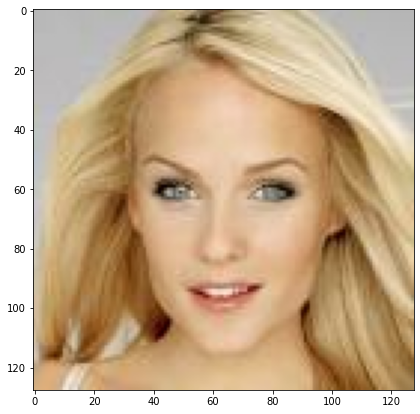

In [2]:
img = tf.io.decode_jpeg(tf.io.read_file("../resources/00002.jpg"))
img = tf.image.convert_image_dtype(img, tf.float32)
plt.figure(figsize=(7, 7))
plt.imshow(img.numpy())
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


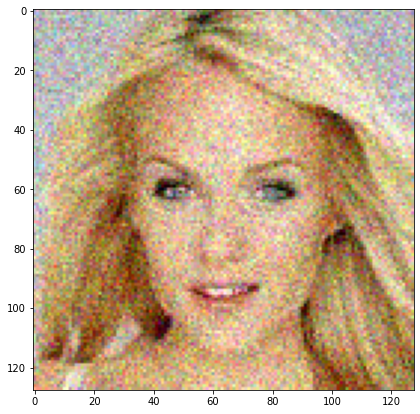

In [3]:
noisy_img = generate_noisy_image(img, 0.99)
plt.figure(figsize=(7, 7))
plt.imshow(noisy_img.numpy())
plt.show()

tf.Tensor(
[9.95000005e-01 9.90026503e-01 9.85079347e-01 ... 9.03713095e-04
 9.01904336e-04 9.00100550e-04], shape=(2000,), dtype=float64)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


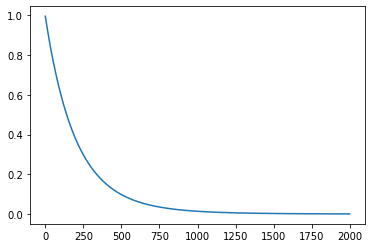

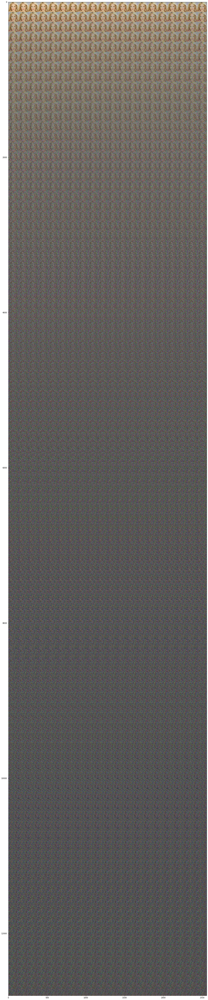

In [3]:
timesteps = 2000
ncols = 20
def gallery(array, ncols=ncols):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    # want result.shape = (height*nrows, width*ncols, intensity)
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

schedule = noise_schedule('linear', 0.995, 0.998, timesteps)
gamma_schedule = tf.math.cumprod(schedule)
print(gamma_schedule)
plt.plot(list(range(gamma_schedule.shape[0])), gamma_schedule.numpy())
noisy_imgs = [img]
for i in range(timesteps):
  noisy_img = generate_noisy_image(noisy_imgs[-1], tf.cast(schedule[i], tf.float32))
  noisy_imgs.append(noisy_img)
noisy_imgs = np.array(noisy_imgs[1:])
plt.figure(figsize=(ncols * 3, timesteps // ncols))
plt.imshow(gallery(noisy_imgs))
plt.show()

In [ ]:
timesteps = 2000
ncols = 20
def gallery(array, ncols=ncols):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    # want result.shape = (height*nrows, width*ncols, intensity)
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

schedule = noise_schedule('linear', 0.995, 0.998, timesteps)
gamma_schedule = tf.math.cumprod(schedule)
print(gamma_schedule)
plt.plot(list(range(gamma_schedule.shape[0])), gamma_schedule.numpy())

tf.Tensor(
[9.95000005e-01 9.90026503e-01 9.85079347e-01 ... 9.03713095e-04
 9.01904336e-04 9.00100550e-04], shape=(2000,), dtype=float64)
